In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
df = pd.read_csv(r'C:\\Users\Renato\OneDrive\Projeto_TERA\Predição Acidentes Motocicleta\Projeto-TERA-Data-Science---Acidentes-Motocicletas\CSVs\df_acidentes_sp_moto.csv')
df.drop(columns=['Unnamed: 0'],inplace=True)
pd.set_option('max_columns', None)
df

C:\Users\Renato\anaconda3\envs\Data_Science\lib\site-packages\IPython\core\interactiveshell.py:3165: DtypeWarning: Columns (7) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


,Data do Acidente,Dia da Semana,Hora do Acidente,Turno,Município,Logradouro,Numero/KM,Jurisdição,Administração,Conservação,Latitude,Longitude,Condições Climáticas,Iluminação,Mão de direção,Relevo,Superfície da via,Tipo de pavimento,Tipo de pista,Traçado,Tipo de Via,Acidente Fatal
0,2021-02-28,DOMINGO,02:29,MADRUGADA,SAO PAULO,RUA TIBURCIO DE SOUSA,1000.0,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,5059","-46,3962",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Vias Municipais,0
1,2021-02-28,DOMINGO,13:47,TARDE,SAO PAULO,RUA ARLINDO BETTIO,727.0,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,4831","-46,4906",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Vias Municipais,0
2,2021-02-28,DOMINGO,21:40,NOITE,SAO PAULO,ACESSO AVENIDA MORVAN DIAS DE FIGUEREDO,1619.0,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,5183","-46,6263",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Vias Municipais,0
3,2021-02-28,DOMINGO,15:14,TARDE,SAO PAULO,RUA TABAPUA,245.0,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,5823389920506","-46,672821094962",BOM,LUZ SOLAR,ÚNICA,PLANO,MOLHADA,ASFALTO,SIMPLES,CRUZAMENTO,Vias Municipais,0
4,2021-02-28,DOMINGO,15:18,TARDE,SAO PAULO,AVENIDA SAO MIGUEL,39.0,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,5281017","-46,3965517",BOM,LUZ SOLAR,DUPLA,INCLINADO,SECA,ASFALTO,DUPLA,DIFICULTA A ESTABILIDADE,Vias Municipais,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62474,2014-12-31,QUARTA,17:30:00,TARDE,MAUA,RUA DA PATRIA,NaN,MUNICIPAL,PREFEITURA,PREFEITURA,-23.6603582802915,-46.4592759802915,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Vias Municipais,1
62475,2014-12-28,DOMINGO,14:30:00,TARDE,CARAPICUIBA,ESTRADA EGILIO VITORELLO,"589,0",MUNICIPAL,PREFEITURA,PREFEITURA,"-23,555237","-46,849214",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Vias Municipais,1
62476,2014-11-05,QUARTA,15:20:00,TARDE,SANTO ANDRE,AVENIDA DOM PEDRO II,"1330,0",MUNICIPAL,PREFEITURA,PREFEITURA,"-23,644498","-46,538558",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Vias Municipais,1
62477,2014-08-10,DOMINGO,16:30:00,TARDE,SAO PAULO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1


In [6]:
df.columns

Index(['Data do Acidente', 'Dia da Semana', 'Hora do Acidente', 'Turno',
       'Município', 'Logradouro', 'Numero/KM', 'Jurisdição', 'Administração',
       'Conservação', 'Latitude', 'Longitude', 'Condições Climáticas',
       'Iluminação', 'Mão de direção', 'Relevo', 'Superfície da via',
       'Tipo de pavimento', 'Tipo de pista', 'Traçado', 'Tipo de Via',
       'Acidente Fatal'],
      dtype='object')

In [7]:
df.isnull().sum()

Data do Acidente            0
Dia da Semana               0
Hora do Acidente          253
Turno                     253
Município                   0
Logradouro                826
Numero/KM                4704
Jurisdição                882
Administração            1402
Conservação              1403
Latitude                  810
Longitude                 810
Condições Climáticas    11529
Iluminação              12540
Mão de direção          13340
Relevo                  13338
Superfície da via       12605
Tipo de pavimento       13339
Tipo de pista           11276
Traçado                 13338
Tipo de Via               788
Acidente Fatal              0
dtype: int64

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62479 entries, 0 to 62478
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Data do Acidente      62479 non-null  object
 1   Dia da Semana         62479 non-null  object
 2   Hora do Acidente      62226 non-null  object
 3   Turno                 62226 non-null  object
 4   Município             62479 non-null  object
 5   Logradouro            61653 non-null  object
 6   Numero/KM             57775 non-null  object
 7   Jurisdição            61597 non-null  object
 8   Administração         61077 non-null  object
 9   Conservação           61076 non-null  object
 10  Latitude              61669 non-null  object
 11  Longitude             61669 non-null  object
 12  Condições Climáticas  50950 non-null  object
 13  Iluminação            49939 non-null  object
 14  Mão de direção        49139 non-null  object
 15  Relevo                49141 non-null

## Modelando Variáveis Ciclicas;

-Data do Acidente
-Dia da Semana
 -Hora do Acidente

In [9]:
df['Data do Acidente'].sample(10)

48109    2019-05-20
10980    2020-09-27
42404    2019-08-01
32066    2019-12-03
57727    2019-01-09
16542    2020-07-21
49678    2019-04-30
21314    2020-05-12
28951    2020-01-17
16652    2020-07-19
Name: Data do Acidente, dtype: object

In [10]:
pd.set_option('max_columns', None)

In [11]:
df[['Ano','Mes','Dia']] = df['Data do Acidente'].str.split('-',expand=True)
df.sample(5)

,Data do Acidente,Dia da Semana,Hora do Acidente,Turno,Município,Logradouro,Numero/KM,Jurisdição,Administração,Conservação,Latitude,Longitude,Condições Climáticas,Iluminação,Mão de direção,Relevo,Superfície da via,Tipo de pavimento,Tipo de pista,Traçado,Tipo de Via,Acidente Fatal,Ano,Mes,Dia
18795,2020-06-20,SÁBADO,20:56,NOITE,SAO PAULO,RUA VOLUNTARIOS DA PATRIA COM RUA HELENA DO SA...,4300.0,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,485497032378","-46,6288322552766",BOM,NOITE (VIA ILUMINADA),DUPLA,PLANO,SECA,ASFALTO,DUPLA,CRUZAMENTO,Vias Municipais,0,2020,06,20
44125,2019-07-08,SEGUNDA,10:37,MANHA,SAO PAULO,PONTE DO SOCORRO,1,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,664351387","-46,708869278",BOM,LUZ SOLAR,ÚNICA,PLANO,SECA,ASFALTO,SIMPLES,RETA,Vias Municipais,0,2019,07,08
22302,2020-04-24,SEXTA,21:04,NOITE,SAO PAULO,AVENIDA MARIA COELHO AGUIAR,1286.0,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,6562488233485","-46,7359020194071",BOM,LUZ SOLAR,DUPLA,PLANO,SECA,ASFALTO,DUPLA,RETA,Vias Municipais,0,2020,04,24
40730,2019-08-21,QUARTA,06:20,MANHA,SAO BERNARDO DO CAMPO,ESTRADA DOS ALVARENGAS,53207,MUNICIPAL,PREFEITURA,PREFEITURA,-23.7569838,-46.6319212,BOM,LUZ SOLAR,ÚNICA,PLANO,MOLHADA,ASFALTO,SIMPLES,RETA,Vias Municipais,0,2019,08,21
26069,2020-02-24,SEGUNDA,19:00,NOITE,ITAQUAQUECETUBA,AVENIDA EMANCIPACAO,100.0,MUNICIPAL,PREFEITURA,PREFEITURA,-23.4793142802915,-46.35470048029149,CHUVA,NOITE (VIA ILUMINADA),ÚNICA,PLANO,MOLHADA,ASFALTO,SIMPLES,CURVA,Vias Municipais,0,2020,02,24


#### - Reorganizando Dataset

In [12]:
df.columns

Index(['Data do Acidente', 'Dia da Semana', 'Hora do Acidente', 'Turno',
       'Município', 'Logradouro', 'Numero/KM', 'Jurisdição', 'Administração',
       'Conservação', 'Latitude', 'Longitude', 'Condições Climáticas',
       'Iluminação', 'Mão de direção', 'Relevo', 'Superfície da via',
       'Tipo de pavimento', 'Tipo de pista', 'Traçado', 'Tipo de Via',
       'Acidente Fatal', 'Ano', 'Mes', 'Dia'],
      dtype='object')

In [13]:
df = df[['Data do Acidente', 'Ano', 'Mes', 'Dia', 'Dia da Semana', 'Hora do Acidente', 'Turno',
       'Município', 'Logradouro', 'Numero/KM', 'Jurisdição', 'Administração',
       'Conservação', 'Latitude', 'Longitude', 'Condições Climáticas',
       'Iluminação', 'Mão de direção', 'Relevo', 'Superfície da via',
       'Tipo de pavimento', 'Tipo de pista', 'Traçado', 'Tipo de Via',
       'Acidente Fatal']]

In [14]:
df.shape # ou seja apenas adicionamos o dia e mes!

(62479, 25)

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62479 entries, 0 to 62478
Data columns (total 25 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Data do Acidente      62479 non-null  object
 1   Ano                   62479 non-null  object
 2   Mes                   62479 non-null  object
 3   Dia                   62479 non-null  object
 4   Dia da Semana         62479 non-null  object
 5   Hora do Acidente      62226 non-null  object
 6   Turno                 62226 non-null  object
 7   Município             62479 non-null  object
 8   Logradouro            61653 non-null  object
 9   Numero/KM             57775 non-null  object
 10  Jurisdição            61597 non-null  object
 11  Administração         61077 non-null  object
 12  Conservação           61076 non-null  object
 13  Latitude              61669 non-null  object
 14  Longitude             61669 non-null  object
 15  Condições Climáticas  50950 non-null

In [16]:
df[['Mes', 'Dia']] = df[['Mes', 'Dia']].astype('int64')

In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62479 entries, 0 to 62478
Data columns (total 25 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Data do Acidente      62479 non-null  object
 1   Ano                   62479 non-null  object
 2   Mes                   62479 non-null  int64 
 3   Dia                   62479 non-null  int64 
 4   Dia da Semana         62479 non-null  object
 5   Hora do Acidente      62226 non-null  object
 6   Turno                 62226 non-null  object
 7   Município             62479 non-null  object
 8   Logradouro            61653 non-null  object
 9   Numero/KM             57775 non-null  object
 10  Jurisdição            61597 non-null  object
 11  Administração         61077 non-null  object
 12  Conservação           61076 non-null  object
 13  Latitude              61669 non-null  object
 14  Longitude             61669 non-null  object
 15  Condições Climáticas  50950 non-null

#### - Modelando - mes

In [18]:
df['Mes'].sample(5)

46763    6
50930    4
27424    2
44627    7
40008    8
Name: Mes, dtype: int64

In [19]:
df['Mes'].describe() # Tudo certo com o mes !

count    62479.000000
mean         6.377919
std          3.540401
min          1.000000
25%          3.000000
50%          7.000000
75%          9.000000
max         12.000000
Name: Mes, dtype: float64

In [20]:
df['Mes_sin']=np.sin(2.*np.pi*df['Mes']/12)
df['Mes_cos']=np.cos(2.*np.pi*df['Mes']/12)

In [21]:
df.sample(5)

,Data do Acidente,Ano,Mes,Dia,Dia da Semana,Hora do Acidente,Turno,Município,Logradouro,Numero/KM,Jurisdição,Administração,Conservação,Latitude,Longitude,Condições Climáticas,Iluminação,Mão de direção,Relevo,Superfície da via,Tipo de pavimento,Tipo de pista,Traçado,Tipo de Via,Acidente Fatal,Mes_sin,Mes_cos
19237,2020-06-13,2020,6,13,SÁBADO,13:44,TARDE,SAO PAULO,AVENIDA ELISEU DE ALMEIDA,1012.0,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,5779192014166","-46,714948892963",BOM,LUZ SOLAR,DUPLA,PLANO,SECA,ASFALTO,MULTIPLA,RETA,Vias Municipais,0,1.224647e-16,-1.000000
17832,2020-07-04,2020,7,4,SÁBADO,02:00,MADRUGADA,SAO PAULO,BR 381,72.0,FEDERAL,CONCESSIONÁRIA-ANTT,AUTOPISTA FERNÃO DIAS,"-23,364558143578073","-46,55234191916073",BOM,NaN,NaN,NaN,NaN,NaN,DUPLA,NaN,Rodovias,0,-5.000000e-01,-0.866025
4497,2020-12-21,2020,12,21,SEGUNDA,20:25,NOITE,SAO PAULO,RUA MUNIZ DE SOUZA,712.0,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,5691837382719","-46,626983890808",BOM,NOITE (VIA ILUMINADA),DUPLA,INCLINADO,SECA,ASFALTO,DUPLA,CRUZAMENTO,Vias Municipais,0,-2.449294e-16,1.000000
35572,2019-10-21,2019,10,21,SEGUNDA,16:09,TARDE,OSASCO,RUA PEDRO FIORETI,48,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,5368110925","-46,7782993872",CHUVA,LUZ SOLAR,ÚNICA,PLANO,MOLHADA,ASFALTO,DUPLA,RETA,Vias Municipais,0,-8.660254e-01,0.500000
2491,2021-01-25,2021,1,25,SEGUNDA,22:01,NOITE,SAO PAULO,RUA HILDEBRANDO SIQUEIRA,10.0,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,6587657908341","-46,6437066274255",CHUVA,NOITE (VIA ILUMINADA),DUPLA,INCLINADO,SECA,ASFALTO,DUPLA,RETA,Vias Municipais,0,5.000000e-01,0.866025


C:\Users\Renato\anaconda3\envs\Data_Science\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Mes_sin', ylabel='Mes_cos'>

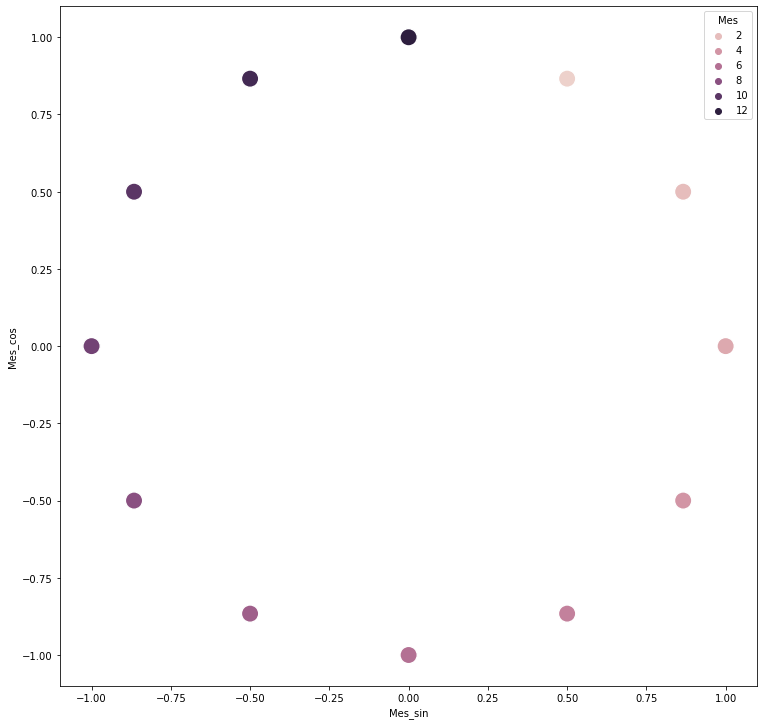

In [22]:
plt.figure(figsize=(12.5,12.5))
sns.scatterplot(df['Mes_sin'],df['Mes_cos'],hue=df['Mes'],s=300)

#### - Modelando - dia da semana

In [23]:
df['Dia da Semana'].value_counts()

SEXTA      10658
SÁBADO      9328
QUINTA      9116
QUARTA      8937
TERÇA       8497
SEGUNDA     8456
DOMINGO     7487
Name: Dia da Semana, dtype: int64

'''Primeiro é necessário transformar o dia da semana em número! O Label Encoder não vai funcionar, pois da ordem aleatória de números,
neste caso precisamos que segunda (1) e depois terça(2), para que os seno e cosseno realmente passem uma ideia ciclica respeitando a 
ordem dos dias da semana'''

In [24]:
# Transformando dia da semana em número e normalizando ela. Como saída teremos 3 colunas novas.

def week_to_feature(df,week_days):
    
    df['dias_semana_num']=df[week_days]
    
    dic = {'DOMINGO':7          
    ,'SÁBADO':6           
    ,'SEXTA':5   
    ,'QUINTA':4    
    ,'QUARTA':3     
    ,'TERÇA':2
    ,'SEGUNDA':1} # Começar com 1 pois caso não seja ira gerar um ciclo com 6 números
        
    for days, num in dic.items():
        
         #print (days)
         #print (num)
         df['dias_semana_num'].replace(days,num,inplace=True)
            
    df['dias_semana_norm']=df['dias_semana_num']/df['dias_semana_num'].max() # normaliza os dias da semana < 1
    
    df['dias_semana_sin']=np.sin(2.*np.pi*df.dias_semana_norm)
    df['dias_semana_cos']=np.cos(2.*np.pi*df.dias_semana_norm)
    
    # Printando o resultado do processo... 
    
    plt.figure(figsize=(12.5,12.5))
    sns.scatterplot(df['dias_semana_sin'],df['dias_semana_cos'],hue=df['Dia da Semana'],s=300)
   

C:\Users\Renato\anaconda3\envs\Data_Science\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


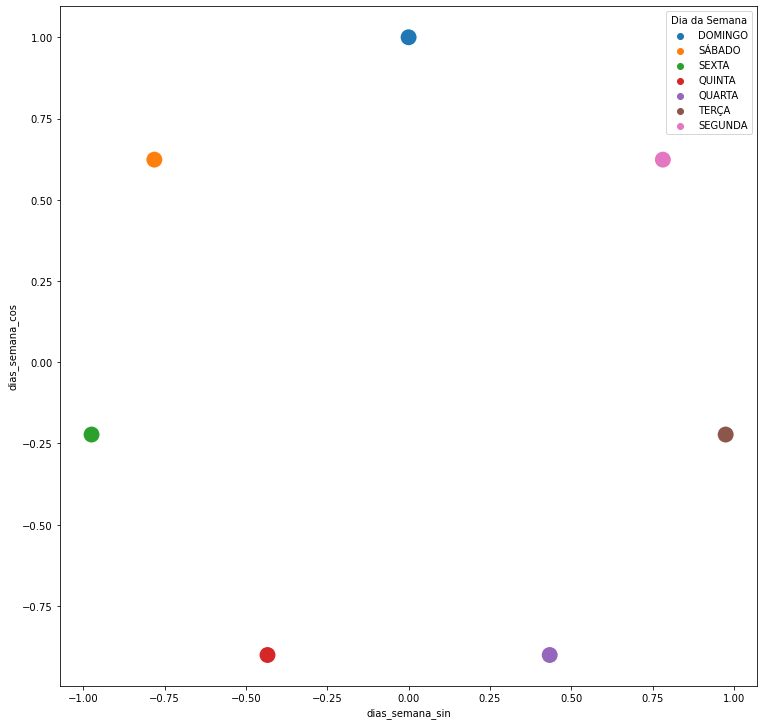

In [25]:
week_to_feature(df,'Dia da Semana')

#### - Modelando - horario

In [26]:
df['Hora do Acidente'].sample(20)

1692        13:56
43567       18:06
25685       21:16
33550       17:21
19433       07:00
33261       18:20
14560       09:24
61023    19:26:00
43199       00:37
40438       15:52
53239       16:15
8441        22:19
14582       16:40
32292       17:03
5843        08:18
44094       22:13
49234       15:44
8863        12:10
17376       20:00
2996        05:50
Name: Hora do Acidente, dtype: object

In [27]:
df[['Hora','Minuto','Segundo']] = df['Hora do Acidente'].str.split(':',expand=True)
df.sample(20)

,Data do Acidente,Ano,Mes,Dia,Dia da Semana,Hora do Acidente,Turno,Município,Logradouro,Numero/KM,Jurisdição,Administração,Conservação,Latitude,Longitude,Condições Climáticas,Iluminação,Mão de direção,Relevo,Superfície da via,Tipo de pavimento,Tipo de pista,Traçado,Tipo de Via,Acidente Fatal,Mes_sin,Mes_cos,dias_semana_num,dias_semana_norm,dias_semana_sin,dias_semana_cos,Hora,Minuto,Segundo
9608,2020-10-16,2020,10,16,SEXTA,21:59,NOITE,GUARULHOS,AVENIDA DA ESTACAO,115.0,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,484936315148","-46,5453829917659",BOM,NOITE (VIA ILUMINADA),ÚNICA,PLANO,SECA,ASFALTO,SIMPLES,RETA,Vias Municipais,0,-8.660254e-01,0.500000,5,0.714286,-9.749279e-01,-0.222521,21,59,None
27708,2020-02-03,2020,2,3,SEGUNDA,10:09,MANHA,SAO PAULO,RUA VIEIRA DE MORAIS,NaN,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,6240335129962","-46,6693877020046",CHUVA,LUZ SOLAR,ÚNICA,PLANO,MOLHADA,ASFALTO,DUPLA,CRUZAMENTO,Vias Municipais,0,8.660254e-01,0.500000,1,0.142857,7.818315e-01,0.623490,10,09,None
62303,2018-05-04,2018,5,4,SEXTA,08:20:00,MANHA,MOGI DAS CRUZES,AVENIDA FRANCISCO FERREIRA LOPES,"1800,0",MUNICIPAL,PREFEITURA,PREFEITURA,"-23,534971","-46,218281",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Vias Municipais,1,5.000000e-01,-0.866025,5,0.714286,-9.749279e-01,-0.222521,08,20,00
47255,2019-05-30,2019,5,30,QUINTA,06:48,MANHA,MAUA,AVENIDA ALBERTO SOARES SAMPAIO,1740,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,6566","-46,4823",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Vias Municipais,0,5.000000e-01,-0.866025,4,0.571429,-4.338837e-01,-0.900969,06,48,None
1773,2021-02-04,2021,2,4,QUINTA,15:43,TARDE,SAO PAULO,RUA BOA VEREDA,36.0,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,564501877884","-46,57304854231",BOM,LUZ SOLAR,DUPLA,INCLINADO,SECA,ASFALTO,DUPLA,CURVA,Vias Municipais,0,8.660254e-01,0.500000,4,0.571429,-4.338837e-01,-0.900969,15,43,None
60031,2018-02-02,2018,2,2,SEXTA,21:28:00,NOITE,SAO PAULO,RUA ARANDU,"394,0",MUNICIPAL,PREFEITURA,PREFEITURA,"-23,608464","-46,692133",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Vias Municipais,1,8.660254e-01,0.500000,5,0.714286,-9.749279e-01,-0.222521,21,28,00
56644,2019-01-25,2019,1,25,SEXTA,14:56,TARDE,SAO PAULO,AVENIDA NORDESTINA,4724,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,5198","-46,4197",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Vias Municipais,0,5.000000e-01,0.866025,5,0.714286,-9.749279e-01,-0.222521,14,56,None
2132,2021-01-30,2021,1,30,SÁBADO,13:30,TARDE,MOGI DAS CRUZES,RUA CATARINA CARRERA MARCATTO,633.0,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,50317748","-46,1478334019999",BOM,LUZ SOLAR,DUPLA,INCLINADO,SECA,ASFALTO,DUPLA,CRUZAMENTO,Vias Municipais,0,5.000000e-01,0.866025,6,0.857143,-7.818315e-01,0.623490,13,30,None
20662,2020-05-23,2020,5,23,SÁBADO,16:49,TARDE,BARUERI,RUA TIETE,1250.0,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,4871485","-46,8835636",BOM,LUZ SOLAR,ÚNICA,INCLINADO,MOLHADA,ASFALTO,DUPLA,CRUZAMENTO,Vias Municipais,0,5.000000e-01,-0.866025,6,0.857143,-7.818315e-01,0.623490,16,49,None
21881,2020-05-01,2020,5,1,SEXTA,13:27,TARDE,SAO PAULO,AVENIDA DOUTOR FRANCISCO MUNHOZ FILHO,1937.0,MUNICIPAL,PREFEITURA,PREFEITURA,"-23,5543778725535","-46,4654184620221",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Vias Municipais,0,5.000000e-01,-0.866025,5,0.714286,-9.749279e-01,-0.222521,13,27,None


In [28]:
df[['Hora','Minuto','Segundo']] = df[['Hora','Minuto','Segundo']].astype('float64')
#dropando a coluna segundo
df.drop('Segundo',axis=1,inplace=True)

In [29]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62479 entries, 0 to 62478
Data columns (total 33 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Data do Acidente      62479 non-null  object 
 1   Ano                   62479 non-null  object 
 2   Mes                   62479 non-null  int64  
 3   Dia                   62479 non-null  int64  
 4   Dia da Semana         62479 non-null  object 
 5   Hora do Acidente      62226 non-null  object 
 6   Turno                 62226 non-null  object 
 7   Município             62479 non-null  object 
 8   Logradouro            61653 non-null  object 
 9   Numero/KM             57775 non-null  object 
 10  Jurisdição            61597 non-null  object 
 11  Administração         61077 non-null  object 
 12  Conservação           61076 non-null  object 
 13  Latitude              61669 non-null  object 
 14  Longitude             61669 non-null  object 
 15  Condições Climática

In [30]:
#preenchendo com fillna avg os acidentes que tem hora,min e seg faltando
df['Hora'].fillna(value=df['Hora'].mode()[0],inplace=True)
df['Minuto'].fillna(value=df['Minuto'].mean(),inplace=True)
# df['Segundo'].fillna(value=df['Segundo'].mean(),inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62479 entries, 0 to 62478
Data columns (total 33 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Data do Acidente      62479 non-null  object 
 1   Ano                   62479 non-null  object 
 2   Mes                   62479 non-null  int64  
 3   Dia                   62479 non-null  int64  
 4   Dia da Semana         62479 non-null  object 
 5   Hora do Acidente      62226 non-null  object 
 6   Turno                 62226 non-null  object 
 7   Município             62479 non-null  object 
 8   Logradouro            61653 non-null  object 
 9   Numero/KM             57775 non-null  object 
 10  Jurisdição            61597 non-null  object 
 11  Administração         61077 non-null  object 
 12  Conservação           61076 non-null  object 
 13  Latitude              61669 non-null  object 
 14  Longitude             61669 non-null  object 
 15  Condições Climática

In [31]:
df['horario_float'] = df['Hora']  + df['Minuto']/60

In [32]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62479 entries, 0 to 62478
Data columns (total 34 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Data do Acidente      62479 non-null  object 
 1   Ano                   62479 non-null  object 
 2   Mes                   62479 non-null  int64  
 3   Dia                   62479 non-null  int64  
 4   Dia da Semana         62479 non-null  object 
 5   Hora do Acidente      62226 non-null  object 
 6   Turno                 62226 non-null  object 
 7   Município             62479 non-null  object 
 8   Logradouro            61653 non-null  object 
 9   Numero/KM             57775 non-null  object 
 10  Jurisdição            61597 non-null  object 
 11  Administração         61077 non-null  object 
 12  Conservação           61076 non-null  object 
 13  Latitude              61669 non-null  object 
 14  Longitude             61669 non-null  object 
 15  Condições Climática

In [33]:
df['horario_float'].sample(5)

55862    22.916667
15371    19.233333
33939    16.383333
36563     6.233333
41485    23.333333
Name: horario_float, dtype: float64

In [34]:
df['horario_sin']=np.sin(2.*np.pi*df['horario_float']/24.)
df['horario_cos']=np.cos(2.*np.pi*df['horario_float']/24.)

C:\Users\Renato\anaconda3\envs\Data_Science\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='horario_sin', ylabel='horario_cos'>

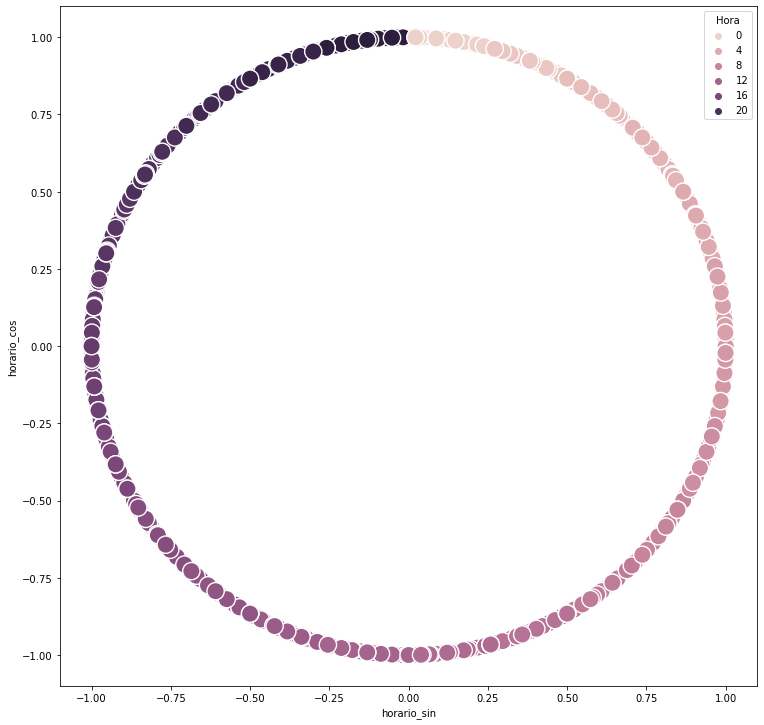

In [35]:
plt.figure(figsize=(12.5,12.5))
sns.scatterplot(df['horario_sin'],df['horario_cos'],s=300,hue=df['Hora'])

In [37]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62479 entries, 0 to 62478
Data columns (total 36 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Data do Acidente      62479 non-null  object 
 1   Ano                   62479 non-null  object 
 2   Mes                   62479 non-null  int64  
 3   Dia                   62479 non-null  int64  
 4   Dia da Semana         62479 non-null  object 
 5   Hora do Acidente      62226 non-null  object 
 6   Turno                 62226 non-null  object 
 7   Município             62479 non-null  object 
 8   Logradouro            61653 non-null  object 
 9   Numero/KM             57775 non-null  object 
 10  Jurisdição            61597 non-null  object 
 11  Administração         61077 non-null  object 
 12  Conservação           61076 non-null  object 
 13  Latitude              61669 non-null  object 
 14  Longitude             61669 non-null  object 
 15  Condições Climática

In [38]:
#criando DF para exportar pro API de clima
df_API_fatais = df[['Data do Acidente','Latitude','Longitude','Condições Climáticas','Hora']].loc[(df['Condições Climáticas'].isnull())&(df['Acidente Fatal']==1)]
df_API_fatais

,Data do Acidente,Latitude,Longitude,Condições Climáticas,Hora
58161,2020-12-31,NaN,NaN,NaN,4.0
58164,2020-12-29,"-23,7464627689999","-46,803836335",NaN,9.0
58168,2020-12-27,NaN,NaN,NaN,18.0
58170,2020-12-26,"-23,458778790416762","-46,48209129083817",NaN,2.0
58171,2020-12-26,"-23,418102298841816","-46,37791152937248",NaN,0.0
...,...,...,...,...,...
62474,2014-12-31,-23.6603582802915,-46.4592759802915,NaN,17.0
62475,2014-12-28,"-23,555237","-46,849214",NaN,14.0
62476,2014-11-05,"-23,644498","-46,538558",NaN,15.0
62477,2014-08-10,NaN,NaN,NaN,16.0


In [47]:
# df_API_fatais.to_csv(r'C:\\Users\Renato\OneDrive\Projeto_TERA\Predição Acidentes Motocicleta\Projeto-TERA-Data-Science---Acidentes-Motocicletas\Weather_API_data\input_API\df_API_fatais.csv',index=False)

# Primeira vez 3200 linhas

In [ ]:
# explorar aquivos 2.1, 2.2

In [39]:
#retornando dados da API de clima
df_from_API = pd.read_csv("C:\\Users\Renato\OneDrive\Projeto_TERA\Predição Acidentes Motocicleta\Projeto-TERA-Data-Science---Acidentes-Motocicletas\Weather_API_data\df_dados_API.csv")

In [40]:
df_from_API.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3200 entries, 0 to 3199
Data columns (total 5 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Data do Acidente      3200 non-null   object
 1   Latitude              3200 non-null   object
 2   Longitude             3200 non-null   object
 3   Condições Climáticas  3200 non-null   object
 4   Hora                  3200 non-null   int64 
dtypes: int64(1), object(4)
memory usage: 125.1+ KB


In [41]:
#criando indice dummy no df do api
df_from_API['Index_BALA']= df_from_API['Data do Acidente']+df_from_API['Latitude']+df_from_API['Longitude']
df_from_API['Index_BALA']

0              2020-12-29-23,7464627689999-46,803836335
1       2020-12-26-23,458778790416762-46,48209129083817
2       2020-12-26-23,418102298841816-46,37791152937248
3        2020-12-26-23,54191853681889-47,01329391534144
4       2020-12-25-23,487367560249513-46,75690361349391
                             ...                       
3195    2015-02-18-23,404111592317488-46,57599535696205
3196                     2015-01-15-23,632392-46,472206
3197                     2014-12-28-23,555237-46,849214
3198                     2014-11-05-23,644498-46,538558
3199                     2012-06-15-23,647306-46,778984
Name: Index_BALA, Length: 3200, dtype: object

In [42]:
#criando indice dummy no df original
df['Index_BALA']= df['Data do Acidente']+df['Latitude']+df['Longitude']
df['Index_BALA']

0                          2021-02-28-23,5059-46,3962
1                          2021-02-28-23,4831-46,4906
2                          2021-02-28-23,5183-46,6263
3         2021-02-28-23,5823389920506-46,672821094962
4                    2021-02-28-23,5281017-46,3965517
                             ...                     
62474    2014-12-31-23.6603582802915-46.4592759802915
62475                  2014-12-28-23,555237-46,849214
62476                  2014-11-05-23,644498-46,538558
62477                                             NaN
62478                  2012-06-15-23,647306-46,778984
Name: Index_BALA, Length: 62479, dtype: object

In [43]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62479 entries, 0 to 62478
Data columns (total 37 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Data do Acidente      62479 non-null  object 
 1   Ano                   62479 non-null  object 
 2   Mes                   62479 non-null  int64  
 3   Dia                   62479 non-null  int64  
 4   Dia da Semana         62479 non-null  object 
 5   Hora do Acidente      62226 non-null  object 
 6   Turno                 62226 non-null  object 
 7   Município             62479 non-null  object 
 8   Logradouro            61653 non-null  object 
 9   Numero/KM             57775 non-null  object 
 10  Jurisdição            61597 non-null  object 
 11  Administração         61077 non-null  object 
 12  Conservação           61076 non-null  object 
 13  Latitude              61669 non-null  object 
 14  Longitude             61669 non-null  object 
 15  Condições Climática

In [44]:
#criando dict para preencher no df
fill_dict = df_from_API.set_index('Index_BALA')['Condições Climáticas'].to_dict()

In [45]:
#usando dict map
df.loc[df['Condições Climáticas'].isnull(), 'Condições Climáticas'] = df['Index_BALA'].map(fill_dict)

In [42]:
df.info() #Boa os 3200 dados foram incluidos

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62479 entries, 0 to 62478
Data columns (total 37 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Data do Acidente      62479 non-null  object 
 1   Ano                   62479 non-null  object 
 2   Mes                   62479 non-null  int64  
 3   Dia                   62479 non-null  int64  
 4   Dia da Semana         62479 non-null  object 
 5   Hora do Acidente      62226 non-null  object 
 6   Turno                 62226 non-null  object 
 7   Município             62479 non-null  object 
 8   Logradouro            61653 non-null  object 
 9   Numero/KM             57775 non-null  object 
 10  Jurisdição            61597 non-null  object 
 11  Administração         61077 non-null  object 
 12  Conservação           61076 non-null  object 
 13  Latitude              61669 non-null  object 
 14  Longitude             61669 non-null  object 
 15  Condições Climática

In [43]:
#exportando um novo dataset com valores ainda faltantes de preencher a condição climática

In [46]:
df_API_fatais2 = df[['Data do Acidente','Latitude','Longitude','Condições Climáticas','Hora']].loc[(df['Condições Climáticas'].isnull())&(df['Acidente Fatal']==1)&(df['Latitude'].notnull())]

In [47]:
df_API_fatais2.to_csv(r'C:\\Users\Renato\OneDrive\Projeto_TERA\Predição Acidentes Motocicleta\Projeto-TERA-Data-Science---Acidentes-Motocicletas\Weather_API_data\input_API\df_API_fatais2.csv',index=False)

In [46]:
# explorar arquivos 2.1 e 2.2

In [48]:
#retornando dados da API de clima
df_from_API2 = pd.read_csv("C:\\Users\Renato\OneDrive\Projeto_TERA\Predição Acidentes Motocicleta\Projeto-TERA-Data-Science---Acidentes-Motocicletas\Weather_API_data\df_dados_API2.csv")

In [49]:
df_from_API2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97 entries, 0 to 96
Data columns (total 5 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Data do Acidente      97 non-null     object 
 1   Latitude              97 non-null     float64
 2   Longitude             97 non-null     float64
 3   Condições Climáticas  97 non-null     object 
 4   Hora                  97 non-null     int64  
dtypes: float64(2), int64(1), object(2)
memory usage: 3.9+ KB


In [50]:
#criando indice dummy no df do api
df_from_API2['Latitude'] = df_from_API2['Latitude'].astype(str)
df_from_API2['Longitude'] = df_from_API2['Longitude'].astype(str)
df_from_API2['Index_BALA']= df_from_API2['Data do Acidente']+df_from_API2['Latitude']+df_from_API2['Longitude']
df_from_API2['Index_BALA']

0      2020-12-25-23.3423100802915-46.7458478802915
1      2020-12-15-23.5074552802915-46.8687358802915
2                  2020-12-15-23.5274237-46.8640458
3      2020-12-04-23.5267139802915-46.5778302802915
4      2020-12-02-23.4382374802915-46.4974011802915
                          ...                      
92    2018-05-06-23.6113486802915-46.59111488029149
93     2018-04-14-23.7007885802915-46.7687816802915
94    2018-02-03-23.4774056802915-46.35269768029149
95    2017-10-09-23.6694175802915-46.73888828029149
96     2014-12-31-23.6603582802915-46.4592759802915
Name: Index_BALA, Length: 97, dtype: object

In [51]:
#criando dict para preencher no df
fill_dict2 = df_from_API2.set_index('Index_BALA')['Condições Climáticas'].to_dict()

In [52]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62479 entries, 0 to 62478
Data columns (total 37 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Data do Acidente      62479 non-null  object 
 1   Ano                   62479 non-null  object 
 2   Mes                   62479 non-null  int64  
 3   Dia                   62479 non-null  int64  
 4   Dia da Semana         62479 non-null  object 
 5   Hora do Acidente      62226 non-null  object 
 6   Turno                 62226 non-null  object 
 7   Município             62479 non-null  object 
 8   Logradouro            61653 non-null  object 
 9   Numero/KM             57775 non-null  object 
 10  Jurisdição            61597 non-null  object 
 11  Administração         61077 non-null  object 
 12  Conservação           61076 non-null  object 
 13  Latitude              61669 non-null  object 
 14  Longitude             61669 non-null  object 
 15  Condições Climática

In [53]:
#usando dict map
df.loc[df['Condições Climáticas'].isnull(), 'Condições Climáticas'] = df['Index_BALA'].map(fill_dict2)

In [54]:
df.info() #97 dados de clima foram colocados pelo df_from_API2

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62479 entries, 0 to 62478
Data columns (total 37 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Data do Acidente      62479 non-null  object 
 1   Ano                   62479 non-null  object 
 2   Mes                   62479 non-null  int64  
 3   Dia                   62479 non-null  int64  
 4   Dia da Semana         62479 non-null  object 
 5   Hora do Acidente      62226 non-null  object 
 6   Turno                 62226 non-null  object 
 7   Município             62479 non-null  object 
 8   Logradouro            61653 non-null  object 
 9   Numero/KM             57775 non-null  object 
 10  Jurisdição            61597 non-null  object 
 11  Administração         61077 non-null  object 
 12  Conservação           61076 non-null  object 
 13  Latitude              61669 non-null  object 
 14  Longitude             61669 non-null  object 
 15  Condições Climática

In [55]:
#dropando colunas que não precisaremos mais
df.drop(columns=['Data do Acidente','Hora do Acidente','Index_BALA'],axis=1,inplace=True)

In [56]:
#Variaveis ciclicas modeladas e dados da API Weather incluidos
#export
df.to_csv('C:\\Users\Renato\OneDrive\Projeto_TERA\Predição Acidentes Motocicleta\Projeto-TERA-Data-Science---Acidentes-Motocicletas\CSVs\df_acidentes_sp_moto_Cyclical2.csv',index=False)
